

# Lab04 template



In [173]:
import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/AllenDowney/ThinkDSP/raw/master/code/thinkdsp.py

import numpy as np
import matplotlib.pyplot as plt

## Exercise 1

''A Soft Murmur'' is a web site that plays a mixture of natural
noise sources, including rain, waves, wind, etc.  At
http://asoftmurmur.com/about/ you can find their list
of recordings, most of which are at http://freesound.org.

Download a few of these files and compute the spectrum of each
signal.  Does the power spectrum look like white noise, pink noise,
or Brownian noise?  How does the spectrum vary over time?

In [174]:
if not os.path.exists('22604__martypinso__dmp010037-crickets-texas.wav'):
    !wget https://github.com/wooftown/spbstu-telecom/raw/main/Content/22604__martypinso__dmp010037-crickets-texas.wav

Возьмём звук свёрчков и вырежем сегемент. Мне кажется шум будет скоррелирован.

In [175]:
from thinkdsp import read_wave

wave = read_wave('22604__martypinso__dmp010037-crickets-texas.wav')
wave.make_audio()

In [176]:
segment = wave.segment(start=10, duration=1.0)
segment.make_audio()

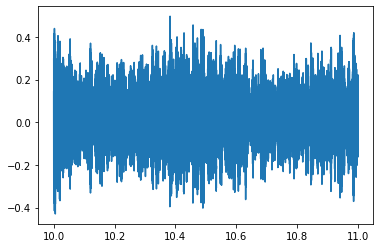

In [177]:
segment.plot()

Для определения характеристик шума используем код из пособия по построению графика спекта в логорифмическом масштабе.

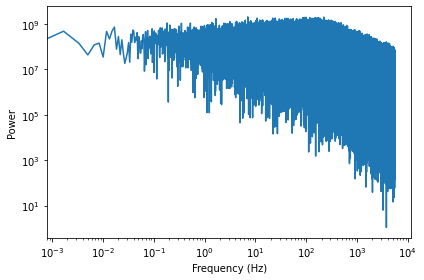

In [178]:
from thinkdsp import decorate
spectrum.plot_power()

loglog = dict(xscale='log', yscale='log')
decorate(xlabel='Frequency (Hz)',
         ylabel='Power', 
         **loglog)

 Давайте возьмём следующий сегмент для наглядности.

In [179]:
segment1 = wave.segment(start=11, duration=1.0)
segment1.make_audio()

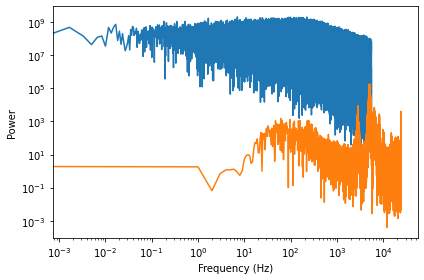

In [180]:
spectrum1 = segment1.make_spectrum()
spectrum.plot_power()
spectrum1.plot_power()


loglog = dict(xscale='log', yscale='log')
decorate(xlabel='Frequency (Hz)',
         ylabel='Power', 
         **loglog)

In [181]:
from thinkdsp import UncorrelatedGaussianNoise
noise = UncorrelatedGaussianNoise()
wave2 = noise.make_wave(duration=1)
spectrum2 = wave2.make_spectrum()

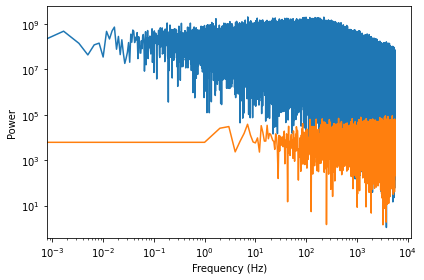

In [182]:
spectrum.plot_power()
spectrum2.plot_power()


loglog = dict(xscale='log', yscale='log')
decorate(xlabel='Frequency (Hz)',
         ylabel='Power', 
         **loglog)

Оранжевым обозначен Гауссов шум.

## Exercise 2
 In a noise signal, the mixture of frequencies changes over time.
In the long run, we expect the power at all frequencies to be equal,
but in any sample, the power at each frequency is random.

To estimate the long-term average power at each frequency, we can
break a long signal into segments, compute the power spectrum for each segment, and then compute the average across
the segments.  You can read more about this algorithm at
http://en.wikipedia.org/wiki/Bartlett's_method.

Implement Bartlett's method and use it to estimate the power
spectrum for a noise wave.  Hint: look at the implementation
of `make_spectrogram`.

Исходя из статьи на википедии надо поделить данные на сегменты, потом для каждого сегмента сделать разложение Фурье, вычислить сумму квадратов и раздлелить на количество элементов и взять от этого всего корень.

Посмотрим с помощью чего и как создаются спектограммы:

        """Initializes a spectrum.
        hs: array of amplitudes (real or complex)
        fs: array of frequencies
        framerate: frames per second
        full: boolean to indicate full or real FFT
        """
        self.hs = np.asanyarray(hs)
        self.fs = np.asanyarray(fs)
        self.framerate = framerate
        self.full = full

    def make_spectrogram(self, seg_length, win_flag=True):
        """Computes the spectrogram of the wave.
        seg_length: number of samples in each segment
        win_flag: boolean, whether to apply hamming window to each segment
        returns: Spectrogram
        """
        if win_flag:
            window = np.hamming(seg_length)
        i, j = 0, seg_length
        step = int(seg_length // 2)

        # map from time to Spectrum
        spec_map = {}

        while j < len(self.ys):
            segment = self.slice(i, j)
            if win_flag:
                segment.window(window)

            # the nominal time for this segment is the midpoint
            t = (segment.start + segment.end) / 2
            spec_map[t] = segment.make_spectrum()

            i += step
            j += step

        return Spectrogram(spec_map, seg_length)

Для создания своей функции надо изменять словать

In [183]:
from thinkdsp import Spectrum

def make_barlett(wave, N, flag=True):
  spectrogram = wave.make_spectrogram(N,flag)
  spec_mac = spectrogram.spec_map.values()

  powers = []
  for spectrum in spec_mac:
    powers.append(spectrum.power)
  
  hs = np.sqrt(sum(powers)/ len(powers))
  fs = next(iter(spec_mac)).fs

  return Spectrum(hs, fs, wave.framerate)

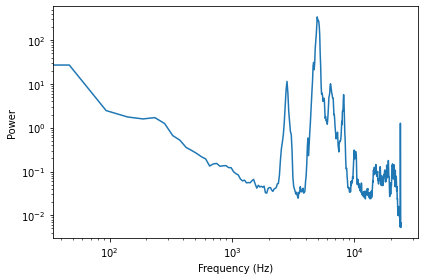

In [184]:
barlett = make_barlett(segment,1024)
barlett.plot_power()

decorate(xlabel='Frequency (Hz)', 
         ylabel='Power', 
         **loglog)

## Exercise 3

At [coindesk](https://www.coindesk.com/price/bitcoin) you can download the daily price of a BitCoin as a CSV file.  Read this file and compute
the spectrum of BitCoin prices as a function of time.
Does it resemble white, pink, or Brownian noise?

In [185]:
  if not os.path.exists('market-price.csv'):
    !wget https://github.com/wooftown/spbstu-telecom/raw/main/Content/market-price.csv

In [186]:
import csv

worth = []

with open('market-price.csv') as File:
  reader = csv.reader(File, delimiter=',', quotechar=',',
                        quoting=csv.QUOTE_MINIMAL)
  worth = [row[1] for row in reader]

worth = worth [1:]
days = a=np.arange(0,len(worth))
print(len(worth), len(days))

1606 1606


In [187]:
print(worth)

['0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0.07', '

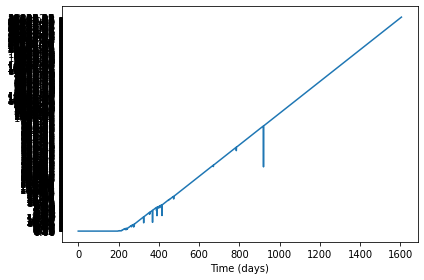

In [188]:
from thinkdsp import Wave

wave = Wave(worth,days,1)
wave.plot()
decorate(xlabel='Time (days)')

График получился не очень красивым из-за того, что слишком много данных, можно приблизить и посмотреть какой-то один сегмент.

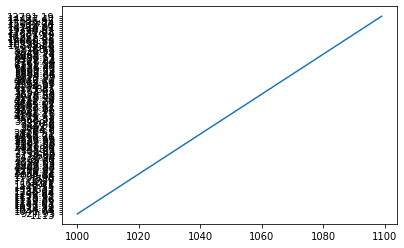

In [189]:
Wave(worth[1000:1100],days[1000:1100],1).plot()

Графики почему то не удались, но давайте перейдём к спектограмме.

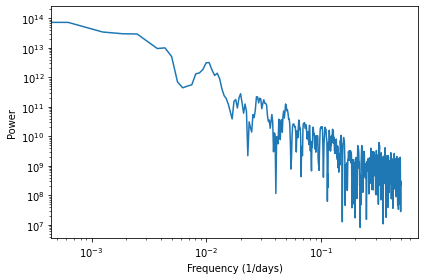

In [190]:
spectrum = wave.make_spectrum()
spectrum.plot_power()
decorate(xlabel='Frequency (1/days)',
         ylabel='Power', 
         **loglog)

Больше всего это походе на красный шум, так как связь похожа на отбраную квадратную.

## Exercise 3

A Geiger counter is a device that detects radiation. When an ionizing particle strikes the detector, it outputs a surge of current. The total output at a point in time can be modeled as uncorrelated Poisson (UP) noise, where each sample is a random quantity from a Poisson distribution, which corresponds to the number of particles detected during an interval.

Write a class called `UncorrelatedPoissonNoise` that inherits from ` _Noise` and provides `evaluate`. It should use `np.random.poisson` to generate random values from a Poisson distribution. The parameter of this function, `lam`, is the average number of particles during each interval. You can use the attribute `amp` to specify `lam`. For example, if the framerate is 10 kHz and `amp` is 0.001, we expect about 10 “clicks” per second.

Generate about a second of UP noise and listen to it. For low values of `amp`, like 0.001, it should sound like a Geiger counter. For higher values it should sound like white noise. Compute and plot the power spectrum to see whether it looks like white noise. 

In [191]:
from thinkdsp import Noise

class UncorrelatedPoissonNoise(Noise):
  def evaluate(self, ts):
    ys = np.random.poisson(self.amp,len(ts))
    return ys

In [192]:
noise1 = UncorrelatedPoissonNoise(0.001)
wave1 = noise1.make_wave(duration=1,framerate = 11025)
wave1.make_audio()

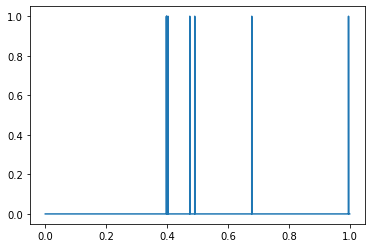

In [193]:
wave1.plot()

In [194]:
noise2 = UncorrelatedPoissonNoise(1)
wave2 = noise2.make_wave(duration=1,framerate = 11025)
wave2.make_audio()

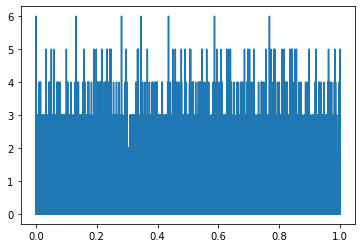

In [195]:
wave2.plot()

In [196]:
spectrum1 = wave1.make_spectrum()
spectrum2 = wave2.make_spectrum()

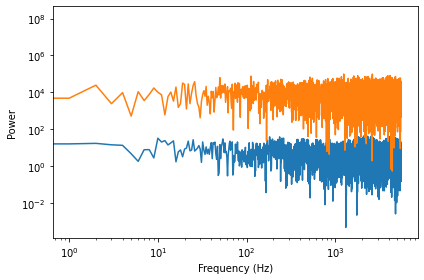

In [197]:
spectrum1.plot_power()
spectrum2.plot_power()

decorate(xlabel='Frequency (Hz)', 
         ylabel='Power', 
         **loglog)

При увеличении значения ампилутуды сигнал всё больше походит на белый шум.

## Exercise 4

The algorithm in this chapter for generating pink noise is
conceptually simple but computationally expensive.  There are
more efficient alternatives, like the Voss-McCartney algorithm.
Research this method, implement it, compute the spectrum of
the result, and confirm that it has the desired relationship
between power and frequency.

In [198]:
def iterpink(depth):
    values = np.random.randn(depth)
    smooth = np.random.randn(depth)
    source = np.random.randn(depth)
    sumvals = values.sum()
    i = 0
    while True:
        yield sumvals + smooth[i]
        i += 1
        if i == depth:
            i = 0
            smooth = np.random.randn(depth)
            source = np.random.randn(depth)
            continue
        c = 0
        while not (i >> c) & 1:
            c += 1
        sumvals += source[i] - values[c]
        values[c] = source[i]

In [205]:
def pink_noise(points, depth=16):
    a = []
    s = iterpink(depth)
    for n in range(points):
        a.append(next(s))
    return np.array(a)

In [200]:
ys = pink_noise(11025,16)
ys

array([-7.7725343 , -8.00898784, -8.10797388, ..., -9.16328781,
       -8.25139184, -7.91636649])

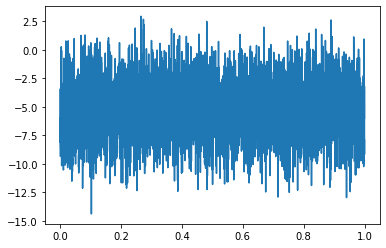

In [201]:
wave = Wave(ys)
wave.plot()

In [202]:
wave.make_audio()

В итоге получили сигнал розового шума:

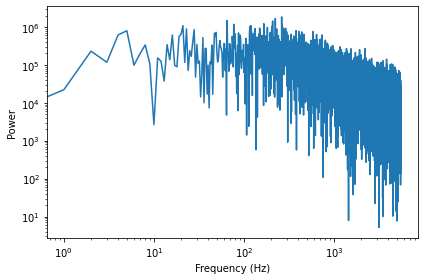

In [204]:
spectrum = wave.make_spectrum()
spectrum.hs[0] = 0
spectrum.plot_power()
decorate(xlabel='Frequency (Hz)',
         ylabel='Power',
         **loglog)